In [1]:
# Get the data into google drive
!wget http://128.138.93.164/nikelululemonadidas_tweets.jsonl.gz

--2023-03-21 22:17:14--  http://128.138.93.164/nikelululemonadidas_tweets.jsonl.gz
Connecting to 128.138.93.164:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 101247175 (97M) [application/octet-stream]
Saving to: ‘nikelululemonadidas_tweets.jsonl.gz’

nikelululemonadidas 100%[===================>]  96.56M  81.4MB/s    in 1.2s    

2023-03-21 22:17:15 (81.4 MB/s) - ‘nikelululemonadidas_tweets.jsonl.gz’ saved [101247175/101247175]



In [94]:
import gzip
import json
import networkx as nx
import matplotlib.pyplot as plt
import spacy
from tqdm import tqdm
from collections import Counter
from itertools import combinations, chain

In [52]:
tweets = []
with gzip.open('/content/nikelululemonadidas_tweets.jsonl.gz') as f:
  for tweet in f:
    tweets.append(json.loads(tweet))

## Twitter Mention Graph for @nike @adidas and @lululemon

We create a directed graph and hydrate it.

In [33]:
DG = nx.DiGraph()

for tweet in tweets:
# The user creating the tweets can be accessed by 
  user = tweet['user']['screen_name']
  # We can then loop through their mentions and add the edges (which will automatically add the nodes) 

  # Need to limit the number of users since our intent is to plot, else runtime will fail (plot exceeds memory) 
  if (tweet['user']['followers_count'] > 300000):
    for mention in tweet['entities']['user_mentions']:
      DG.add_edge(user, mention['screen_name'])

In [34]:
print(DG)

DiGraph with 706 nodes and 926 edges


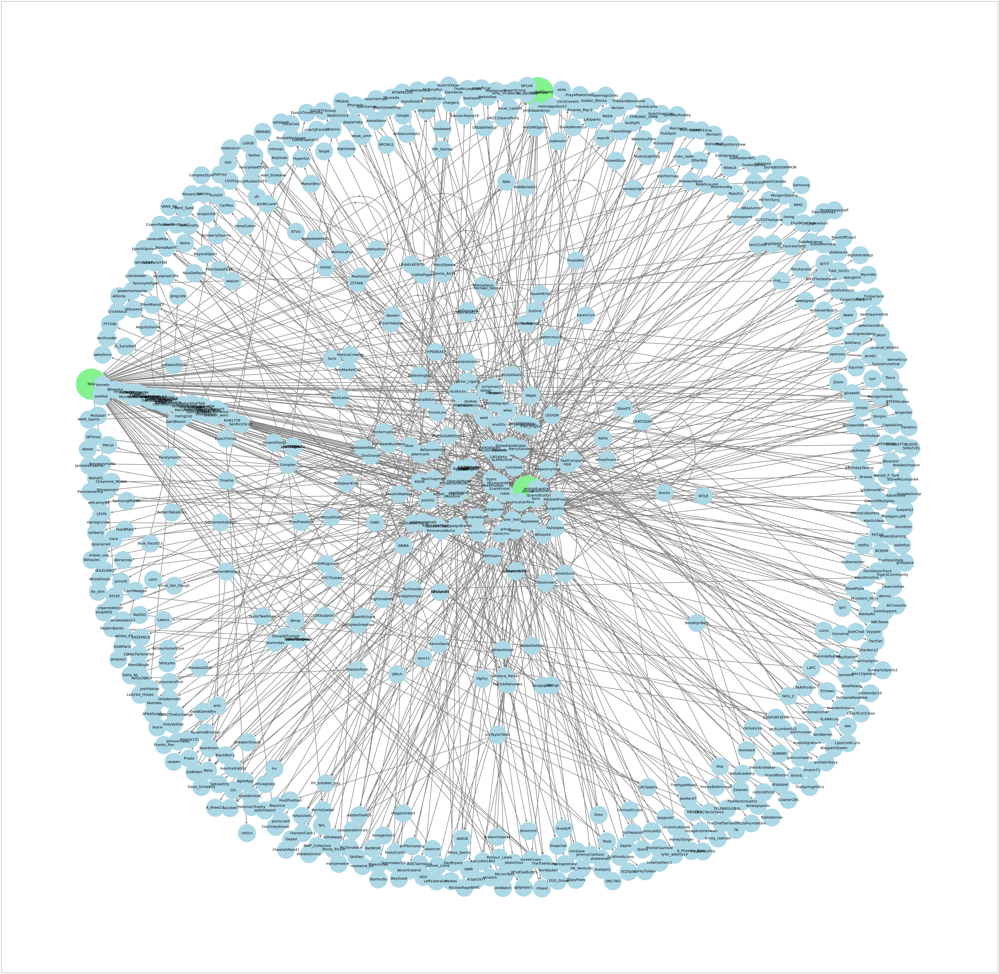

In [51]:
# Set the brands to be colored green
node_colors = ['#83F28F' if node in ['Nike', 'lululemon', 'adidas'] else '#ADD8E6' for node in DG]
node_size = [30000 if node in ['Nike', 'lululemon', 'adidas'] else 10000 for node in DG]

# Plot the graph 
fig, ax = plt.subplots(1, 1, figsize=(100, 100))
nx.draw_networkx(DG, ax=ax, pos=nx.spring_layout(DG), node_color=node_colors, font_color="#000000", edge_color = '#808080', font_size=20, node_size=node_size, width=3, arrowsize=20)

Looking at the clusters, Nike is closer to fashion outlets while Adidas is clustered with sport teams, both are also joined by sports figures and celebrities. Lululemon seems to be further out from the shoe brands, they are connected by users with brand names in their user names itself, so maybe superfans or other celebrities.

## Semantic Network Graph

We'll first clean up the tweets

In [54]:
!python -m spacy download en_core_web_md

/usr/local/lib/python3.9/dist-packages/torch/cuda/__init__.py:497: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")
2023-03-21 23:19:57.294708: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-21 23:19:57.295060: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/nvidia/lib:/usr/local/nvidia/lib64
2023-03-21 23:19:57.295097: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentione

In [75]:
# Load a medium trained model
nlp = spacy.load("en_core_web_md")

In [76]:
def cleaner(note):
    """Remove stop words, punctuations, convert words into lemma_"""
    doc = nlp(note)
    note = (" ".join([token.lemma_ for token in doc \
                      if not token.is_stop \
                          and not token.is_punct \
                          and not token.like_num\
                          and not token.like_url\
                          and not token.like_email
                          and token.is_alpha]))    
    note = note.lower()
    return note

In [77]:
print(tweets[0]['full_text'])
cleaner(tweets[0]['full_text'])

#ad The Nike Women's Air More Uptempo 96 'White/Opti Yellow' is now available via @footlocker! |$160| #SneakerScouts @Nike https://t.co/5lAq7b2ffU https://t.co/wmjxIcsheP


'ad nike women air uptempo white opti yellow available sneakerscouts'

In [86]:
all_tweets = []

for tweet in tqdm(tweets):
  # Limiting the number of users again ~ 8 mins
  if (tweet['user']['followers_count'] > 10000):
    all_tweets.append(cleaner(tweet['full_text']))

100%|██████████| 175078/175078 [03:48<00:00, 766.91it/s]


In [109]:
keywords_counts = Counter(list(chain(*[x.split(' ') for x in all_tweets])))
top_50_words = sorted(keywords_counts, key=keywords_counts.get, reverse=True)[:50]

In [110]:
graph = nx.Graph()

for tweet in all_tweets:
  nodes = [t for t in tweet.split(' ') if t in top_50_words]
  graph.add_edges_from(tuple(combinations(nodes, 2)))

In [111]:
print(graph)

Graph with 49 nodes and 805 edges


/usr/local/lib/python3.9/dist-packages/networkx/drawing/nx_pylab.py:304: UserWarning: 

The arrowsize keyword argument is not applicable when drawing edges
with LineCollection.

To make this warning go away, either specify `arrows=True` to
force FancyArrowPatches or use the default value for arrowsize.
Note that using FancyArrowPatches may be slow for large graphs.

  draw_networkx_edges(G, pos, arrows=arrows, **edge_kwds)


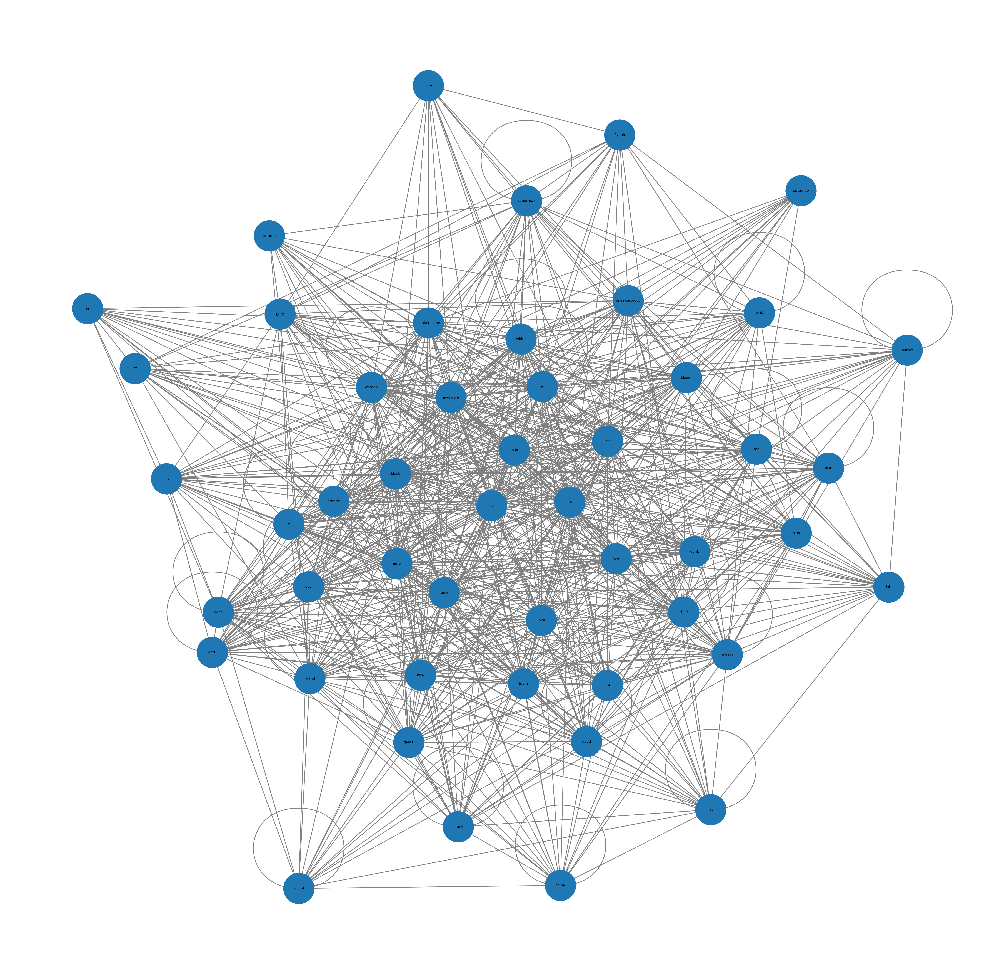

In [112]:
fig, ax = plt.subplots(1, 1, figsize=(100, 100))
nx.draw_networkx(graph, ax=ax, font_color="#000000", edge_color = '#808080', font_size=20, node_size=30000, width=4, arrowsize=100)

The semantic graph shows the top keywords and how they interact with each other. 